## 1> Using new datasets to rain the new MelodyRNN model 

Most of the code came from: 

https://github.com/magenta/magenta/tree/main/magenta/models/melody_rnn 
& 
https://colab.research.google.com/notebooks/magenta/hello_magenta/hello_magenta.ipynb#scrollTo=71dgCmmBli-s


Dataset came from: 

https://github.com/jukedeck/nottingham-dataset

In [1]:
!pip install magenta

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.4 MB 5.3 MB/s 
     |████████████████████████████████| 204 kB 15.5 MB/s 
     |████████████████████████████████| 254 kB 57.1 MB/s 
     |████████████████████████████████| 1.6 MB 59.8 MB/s 
     |████████████████████████████████| 2.3 MB 32.0 MB/s 
     |████████████████████████████████| 3.6 MB 47.2 MB/s 
     |████████████████████████████████| 210 kB 53.1 MB/s 
     |████████████████████████████████| 5.6 MB 53.7 MB/s 
     |████████████████████████████████| 69 kB 6.7 MB/s 
     |████████████████████████████████| 1.4 MB 57.1 MB/s 
     |████████████████████████████████| 352 kB 75.4 MB/s 
     |████████████████████████████████| 90 kB 9.6 MB/s 
     |████████████████████████████████| 20.2 MB 1.5 MB/s 
     |████████████████████████████████| 48 kB 4.6 MB/s 
     |████████████████████████████████| 193 kB 54.2 MB/s 
     |████████████████████████████████

In [2]:
!git clone https://github.com/magenta/magenta

Cloning into 'magenta'...
remote: Enumerating objects: 15841, done.
remote: Total 15841 (delta 0), reused 0 (delta 0), pack-reused 15841
Receiving objects: 100% (15841/15841), 36.37 MiB | 16.18 MiB/s, done.
Resolving deltas: 100% (12051/12051), done.


In [3]:
!pip install pyfluidsynth

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
#initial setup enviroment
print('Installing dependencies...')
!apt-get update -qq && apt-get install -qq libfluidsynth1 fluid-soundfont-gm build-essential libasound2-dev libjack-dev
!pip install -qU pyfluidsynth pretty_midi

!pip install -qU magenta

# Hack to allow python to pick up the newly-installed fluidsynth lib. 
# This is only needed for the hosted Colab environment.
import ctypes.util
orig_ctypes_util_find_library = ctypes.util.find_library
def proxy_find_library(lib):
  if lib == 'fluidsynth':
    return 'libfluidsynth.so.1'
  else:
    return orig_ctypes_util_find_library(lib)
ctypes.util.find_library = proxy_find_library

print('Importing libraries and defining some helper functions...')
from google.colab import files
from note_seq import midi_io

import magenta
import note_seq

#there are something wrong with 

#import tensorflow as tf

import tensorflow.compat.v1 as tf
import note_seq

print('🎉 Done!')
print(magenta.__version__)
#print(tensorflow.__version__)

Installing dependencies...
Selecting previously unselected package fluid-soundfont-gm.
(Reading database ... 155639 files and directories currently installed.)
Preparing to unpack .../fluid-soundfont-gm_3.1-5.1_all.deb ...
Unpacking fluid-soundfont-gm (3.1-5.1) ...
Selecting previously unselected package libfluidsynth1:amd64.
Preparing to unpack .../libfluidsynth1_1.1.9-1_amd64.deb ...
Unpacking libfluidsynth1:amd64 (1.1.9-1) ...
Setting up fluid-soundfont-gm (3.1-5.1) ...
Setting up libfluidsynth1:amd64 (1.1.9-1) ...
Processing triggers for libc-bin (2.27-3ubuntu1.3) ...
/sbin/ldconfig.real: /usr/local/lib/python3.7/dist-packages/ideep4py/lib/libmkldnn.so.0 is not a symbolic link

Importing libraries and defining some helper functions...


/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit


🎉 Done!
2.1.3


In [5]:
#download datasets

!git clone https://github.com/jukedeck/nottingham-dataset

Cloning into 'nottingham-dataset'...
remote: Enumerating objects: 3119, done.
remote: Total 3119 (delta 0), reused 0 (delta 0), pack-reused 3119
Receiving objects: 100% (3119/3119), 879.17 KiB | 14.18 MiB/s, done.
Resolving deltas: 100% (1432/1432), done.


In [ ]:
#change the midi files to notesequences

INPUT_DIRECTORY_1='/content/nottingham-dataset/MIDI'
# TFRecord file that will contain NoteSequence protocol buffers.
SEQUENCES_TFRECORD_1='/content/tmp/notesequences.tfrecord'

!python /content/magenta/magenta/scripts/convert_dir_to_note_sequences.py --input_dir={INPUT_DIRECTORY_1} --output_file={SEQUENCES_TFRECORD_1} --recursive

In [58]:
#dataset testing

full_file_path = '/content/nottingham-dataset/MIDI/ashover1.mid'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)
print('🎵ashover1.mid')
note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

/usr/local/lib/python3.7/dist-packages/pretty_midi/pretty_midi.py:101: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  RuntimeWarning)


🎵ashover1.mid


In [7]:
#create datasets with 0.1 evaluation data

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_create_dataset.py --config='lookback_rnn' --input='/content/tmp/notesequences.tfrecord' --output_dir='/content/tmp/melody_rnn/sequence_examples' --eval_ratio=0.10

流式输出内容被截断，只能显示最后 5000 行内容。
W0618 14:20:29.185826 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.214505 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.242730 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.270509 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.296759 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.327803 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.363043 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.390147 140444209252224 note_sequence_pipelines.py:174] Key signatures ignored by TranspositionPipeline.
W0618 14:20:29.408773

In [ ]:
#train the train set

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_train.py --config='lookback_rnn' --run_dir='/content/tmp/melody_rnn/logdir/run1' --sequence_example_file='/content/tmp/melody_rnn/sequence_examples/training_melodies.tfrecord' --hparams="batch_size=64,rnn_layer_sizes=[64,64]" --num_training_steps=2000

In [14]:
#generate with exsiting midi file

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_generate.py --config='lookback_rnn' --run_dir='/content/tmp/melody_rnn/logdir/run1' --output_dir='/content/tmp/melody_rnn/generated2' --num_outputs=10 --num_steps=1024 --hparams="batch_size=64,rnn_layer_sizes=[64,64]" --primer_midi='/content/tmp/melody_rnn/generated1/2022-06-18_145759_01.mid'

/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
Instructions for updating:
non-resource variables are not supported in the long term
2022-06-18 15:05:27.176418: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-cap

In [11]:
#generate new midi file starting with #C

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_generate.py --config='lookback_rnn' --run_dir='/content/tmp/melody_rnn/logdir/run1' --output_dir='/content/tmp/melody_rnn/generated1' --num_outputs=10 --num_steps=512 --hparams="batch_size=64,rnn_layer_sizes=[64,64]" --primer_melody='[60]'

/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
Instructions for updating:
non-resource variables are not supported in the long term
2022-06-18 14:57:59.802802: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-cap

In [53]:
full_file_path = '/content/tmp/melody_rnn/generated1/2022-06-18_145759_01.mid'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)


In [16]:
sequence

ticks_per_quarter: 220
time_signatures {
  numerator: 4
  denominator: 4
}
tempos {
  qpm: 120.0
}
notes {
  pitch: 60
  velocity: 100
  end_time: 0.125
}
notes {
  pitch: 67
  velocity: 100
  start_time: 1.0
  end_time: 2.0
}
notes {
  pitch: 72
  velocity: 100
  start_time: 2.0
  end_time: 2.5
}
notes {
  pitch: 72
  velocity: 100
  start_time: 2.5
  end_time: 3.25
}
notes {
  pitch: 69
  velocity: 100
  start_time: 3.25
  end_time: 3.5
}
notes {
  pitch: 60
  velocity: 100
  start_time: 3.5
  end_time: 4.0
}
notes {
  pitch: 70
  velocity: 100
  start_time: 4.0
  end_time: 4.125
}
notes {
  pitch: 65
  velocity: 100
  start_time: 4.5
  end_time: 5.0
}
notes {
  pitch: 67
  velocity: 100
  start_time: 5.0
  end_time: 6.0
}
notes {
  pitch: 74
  velocity: 100
  start_time: 6.0
  end_time: 6.5
}
notes {
  pitch: 72
  velocity: 100
  start_time: 6.5
  end_time: 7.0
}
notes {
  pitch: 74
  velocity: 100
  start_time: 7.0
  end_time: 7.25
}
notes {
  pitch: 69
  velocity: 100
  start_time

In [54]:
note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉generated1/2022-06-18_145759_01.mid🎉')

🎉generated1/2022-06-18_145759_01.mid🎉


In [19]:
from note_seq.protobuf import music_pb2
# This is a colab utility method that visualizes a NoteSequence.
note_seq.plot_sequence(sequence)

# This is a colab utility method that plays a NoteSequence.
note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉generated2/2022-06-18_150527_04.mid🎉')

🎉generated2/2022-06-18_150527_04.mid🎉


In [21]:
note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉generated1/2022-06-18_145759_08.mid🎉')

🎉generated1/2022-06-18_145759_08.mid🎉


In [61]:
full_file_path = '/content/tmp/melody_rnn/generated1/2022-06-18_145759_07.mid'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)
print('🎹generated1/2022-06-18_145759_07.mid🎵')
note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

🎹generated1/2022-06-18_145759_07.mid🎵


# 2> Using LSTM modle to train and generate new sounds

This part of code came from: https://colab.research.google.com/drive/1cCq-NNv62ofKU8rpx8uI_YwinWAeYZ7U?usp=sharing

In [23]:
import sys
import librosa
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
import os
import tensorflow
import numpy as np

In [24]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


22050


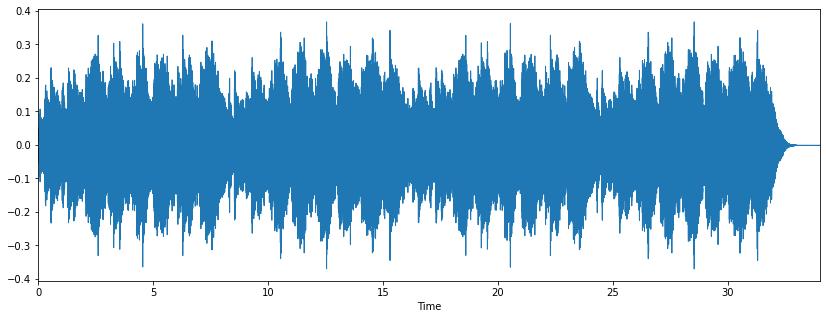

In [25]:
# Specify a filename on your drive, or alternatively upload something to the colab folder
# Something about 20 seconds long is a good start. 
filename1 = "/content/drive/MyDrive/638906__josefpres__piano-loops-018-octave-short-loop-120-bpm.wav"

# You only need to do this if you want to plot the figure
#x, sr = librosa.load(filename,sr=None)
x, sr = librosa.load(filename1) # will default to 22050

print (sr)

plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)


# This lets you play the audio file. You can also load arrays and play those 
ipd.Audio(filename1) # load a local WAV file


22050


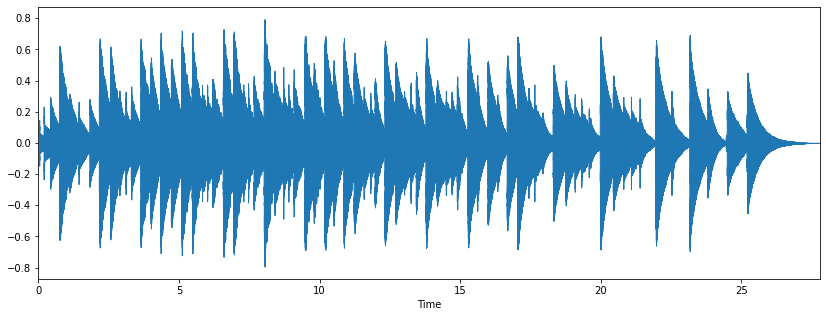

In [38]:
# Specify a filename on your drive, or alternatively upload something to the colab folder
# Something about 20 seconds long is a good start. 
#filename1 = "/content/drive/MyDrive/638906__josefpres__piano-loops-018-octave-short-loop-120-bpm.wav"
filename2 = "/content/drive/MyDrive/369148__flying-deer-fx__music-box-the-flea-waltz.wav"

# You only need to do this if you want to plot the figure
#x, sr = librosa.load(filename,sr=None)
x, sr = librosa.load(filename2) # will default to 22050

print (sr)

plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)


# This lets you play the audio file. You can also load arrays and play those 
ipd.Audio(filename2) # load a local WAV file

In [39]:
data_tf = tensorflow.convert_to_tensor(x, np.float32)
data_tf.shape

TensorShape([612758])

In [40]:
n = tensorflow.signal.stft(data_tf,2048,512)

In [41]:
magnitude_spectrograms = tensorflow.abs(n)

In [42]:
#we need to get all the fft frames and organise them into sequence batches
start = 0
sequence_length = 40
end = magnitude_spectrograms.shape[0] - sequence_length - 1
step = 1
x_frames = []
y_frames = []
for i in range(start, end, step):
    done = int(float(i) / float(end) * 100.0)
    sys.stdout.write('{}% data generation complete.   \r'.format(done))
    sys.stdout.flush()
    x = magnitude_spectrograms[i:i+sequence_length]
    y = magnitude_spectrograms[i+sequence_length]
    x_frames.append(x)
    y_frames.append(y)
x_frames = np.array(x_frames)
y_frames = np.array(y_frames)

In [45]:
learning_rate        = 0.001
amount_epochs        = 300
batch_size           = 64
loss_type            = "msle"
weight_decay         = 0.0001



# Recurrent Neural Network
rnn_type             = "lstm"
number_rnn_layers    = 2
rnn_number_units     = 128
model = tensorflow.keras.Sequential()

model.add(tensorflow.keras.layers.BatchNormalization(input_shape=[x_frames.shape[1], x_frames.shape[2]]))

for layer in range(number_rnn_layers):
    return_sequence = False if layer == (number_rnn_layers - 1) else True
    model.add(tensorflow.keras.layers.LSTM(rnn_number_units, return_sequences= return_sequence))
    
model.add(tensorflow.keras.layers.Dense(y_frames.shape[1]))

model.add(tensorflow.keras.layers.Activation('linear'))
opt = tensorflow.keras.optimizers.Adam(learning_rate)
model.compile(optimizer=opt, loss=loss_type)

In [46]:
#train the rnn model

model.fit(x_frames, y_frames, batch_size=batch_size, epochs=amount_epochs)

Epoch 1/300
18/18 [==============================] - 11s 427ms/step - loss: 15.7441
Epoch 2/300
18/18 [==============================] - 9s 498ms/step - loss: 14.4201
Epoch 3/300
18/18 [==============================] - 8s 449ms/step - loss: 13.4452
Epoch 4/300
18/18 [==============================] - 8s 425ms/step - loss: 12.6767
Epoch 5/300
18/18 [==============================] - 8s 417ms/step - loss: 12.0477
Epoch 6/300
18/18 [==============================] - 7s 412ms/step - loss: 11.5133
Epoch 7/300
18/18 [==============================] - 8s 418ms/step - loss: 11.0479
Epoch 8/300
18/18 [==============================] - 7s 414ms/step - loss: 10.5561
Epoch 9/300
18/18 [==============================] - 8s 423ms/step - loss: 10.0786
Epoch 10/300
18/18 [==============================] - 8s 429ms/step - loss: 9.6443
Epoch 11/300
18/18 [==============================] - 8s 457ms/step - loss: 9.2365
Epoch 12/300
18/18 [==============================] - 8s 439ms/step - loss: 8.8737
Epo

In [47]:
# Generate an audio file

import soundfile as sf
sequence_length_max = 512
impulse_scale       = 1.0
random_chance       = 0.01
random_strength     = 0.2
window_size = 1024

dimension1 = x_frames.shape[1]
dimension2 = x_frames.shape[2]
shape = (1, dimension1, dimension2)

audio = []
random_index = np.random.randint(0, (len(x_frames) - 1))                                                                                                                    
impulse = np.array(x_frames[random_index]) * impulse_scale
predicted_magnitudes = impulse
   
for j in range(sequence_length_max):
    prediction = model.predict(impulse.reshape(shape))
    predicted_magnitudes = np.vstack((predicted_magnitudes, prediction))
    impulse = predicted_magnitudes[-sequence_length:]
    if (np.random.random_sample() < random_chance) :
        np.random.seed()
        random_index = np.random.randint(0, (len(x_frames) - 1))                                                                                                                    
        impulse = np.array(x_frames[random_index]) * impulse_scale
 
predicted_magnitudes = np.array(predicted_magnitudes).reshape(-1, window_size+1)

audio = librosa.griffinlim(predicted_magnitudes.T)

sf.write('gen_test2.wav', audio, 22050, 'PCM_24')

audio = np.array(audio)

In [33]:
ipd.Audio('gen_test1.wav', rate=sr)

In [48]:
ipd.Audio('gen_test2.wav', rate=sr)

I tried to convert the .wav into .mid but it's not working. So I used  https://anyconv.com/wav-to-midi-converter/ to convert into midi file

In [35]:
full_file_path = '/content/AnyConv.com__gen_test1.midi'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉gen_test1.wav🎉')

🎉gen_test1.wav🎉


In [49]:
full_file_path = '/content/AnyConv.com__gen_test2.midi'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉gen_test2🎉')

🎉gen_test2🎉


# 3> Using built MelodyRNN model from 1> to generate new song with the generated sounds in 2> 

In [36]:
#generate with exsiting midi file: /content/AnyConv.com__gen_test1.midi

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_generate.py --config='lookback_rnn' --run_dir='/content/tmp/melody_rnn/logdir/run1' --output_dir='/content/tmp/melody_rnn/generated2' --num_outputs=10 --num_steps=1024 --hparams="batch_size=64,rnn_layer_sizes=[64,64]" --primer_midi='/content/AnyConv.com__gen_test1.midi'

/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
Instructions for updating:
non-resource variables are not supported in the long term
2022-06-18 17:20:11.591644: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-cap

In [37]:
full_file_path = '/content/tmp/melody_rnn/generated2/2022-06-18_172011_05.mid'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉generated2/2022-06-18_172011_05.mid🎉')

🎉generated2/2022-06-18_172011_05.mid🎉


In [50]:
#generate with exsiting midi file: /content/AnyConv.com__gen_test2.midi

!python /content/magenta/magenta/models/melody_rnn/melody_rnn_generate.py --config='lookback_rnn' --run_dir='/content/tmp/melody_rnn/logdir/run1' --output_dir='/content/tmp/melody_rnn/generated2' --num_outputs=10 --num_steps=512 --hparams="batch_size=64,rnn_layer_sizes=[64,64]" --primer_midi='/content/AnyConv.com__gen_test2.midi'

/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
/usr/local/lib/python3.7/dist-packages/librosa/util/decorators.py:9: NumbaDeprecationWarning: An import was requested from a module that has moved location.
Import of 'jit' requested from: 'numba.decorators', please update to use 'numba.core.decorators' or pin to Numba version 0.48.0. This alias will not be present in Numba version 0.50.0.
  from numba.decorators import jit as optional_jit
Instructions for updating:
non-resource variables are not supported in the long term
2022-06-18 18:38:54.566733: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-cap

In [51]:
full_file_path = '/content/tmp/melody_rnn/generated2/2022-06-18_183854_03.mid'

try:
  sequence = midi_io.midi_to_sequence_proto(
      tf.gfile.GFile(full_file_path, 'rb').read())
except midi_io.MIDIConversionError as e:
  tf.logging.warning(
      'Could not parse MIDI file %s. It will be skipped. Error was: %s',
      full_file_path, e)

note_seq.plot_sequence(sequence)

note_seq.play_sequence(sequence,synth=note_seq.fluidsynth)

print('🎉generated2/2022-06-18_183854_03.mid🎉')

🎉generated2/2022-06-18_183854_03.mid🎉


In [62]:
!zip -r /content/generated2.zip /content/tmp/melody_rnn/generated2

  adding: content/tmp/melody_rnn/generated2/ (stored 0%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_150527_04.mid (deflated 70%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_172011_10.mid (deflated 73%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_05.mid (deflated 84%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_150527_01.mid (deflated 69%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_172011_01.mid (deflated 73%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_09.mid (deflated 69%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_01.mid (deflated 87%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_04.mid (deflated 83%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_10.mid (deflated 82%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_07.mid (deflated 84%)
  adding: content/tmp/melody_rnn/generated2/2022-06-18_183854_03.mid (deflated 86%)
  adding: content/t

In [ ]:
from google.colab import files
files.download("/content/file.zip")